# Face ROI Extraction

In [68]:
from pathlib import Path
import numpy as np
import pandas as pd
from nilearn import plotting, image
import nibabel as nib
import numpy as np
from scipy import stats
import cv2 as cv
from PIL import Image

In [69]:
# Image helper functions
def show_bgr(img): 
    return Image.fromarray(img[:,:,::-1])

def show_blob(blob):
    return Image.fromarray(blob[0].transpose(1,2,0).astype('uint8'))

def get_detect_img(stimulus):
    p = next(dataset_v2.glob(f'**/{stimulus.image}'))
    img = cv.imread(str(p))
    
    if stimulus.faces:
        for face in stimulus.faces:
            confidence, x1, y1, x2, y2 = face
            cv.rectangle(img,(x1,y1),(x2,y2),(0, 0, 255),2)
            cv.putText(img, f'{confidence:2.2%}', (x1, y2+30), cv.FONT_HERSHEY_SIMPLEX, 1, (0,255,0), 1, 1, bottomLeftOrigin=False)

    cv.putText(img, f'{stimulus.dataset}', (1, 32), cv.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    return img

def random_collage(df):
    # Get random sample
    sample = df.sample(40)

    rows=[]
    for row in range(10):
        cols=[]
        for col in range(4):
            cols.append(get_detect_img(sample.iloc[row * 4 + col]))
        rows.append(np.hstack(cols))
    collage = np.vstack(rows)

    return show_bgr(collage)

# Face detection sorting
def face_size(faces, min_area=14063, min_confidence=0.9):
    if not faces:
        return False
    
    for face in faces:
        # Calculate face bounding box area
        area = (face[3] - face[1]) * (face[4] - face[2])
        confidence = face[0]
        
        if area > min_area and confidence > min_confidence:
            return True
        
    return False

In [8]:
dataset_v1 = Path('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000')
dataset_v2 = Path('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000r2')

In [4]:
csi3_anat = nib.load(dataset_v1 / 'BOLD5000_Structural' / 'CSI3_Structural' / 'T1w_MPRAGE_CSI3.nii')
csi3_img = nib.load(dataset_v2 / f'CSI3_GLMbetas-TYPED-FITHRF-GLMDENOISE-RR-ZSCORE-ALL.nii.gz')
#csi3_img = nib.load(dataset_v2 / f'CSI3_SPMResids_allsess_TR34.nii.gz')
#csi3_img = image.smooth_img(str(dataset_v2 / f'CSI3_GLMbetas-TYPED-FITHRF-GLMDENOISE-RR-ZSCORE-ALL.nii.gz'), fwhm=6)

csi3_data = image.get_data(csi3_img)

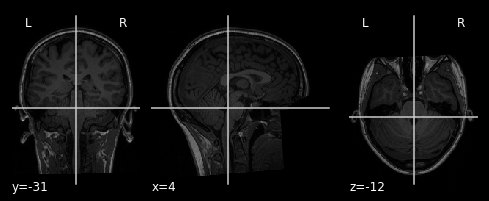

In [5]:
plotting.plot_anat(csi3_anat)

In [6]:
csi3_data.shape

(72, 88, 67, 5254)

In [34]:
# Load face detection dataframe
face_df = pd.read_pickle('face-detection-df.pkl')
# Load CSI3 image presentation data
csi3_df = pd.read_pickle(dataset_v2 / 'CSI3_dataframe.pkl')
# Merge faces and image names
csi3_df = csi3_df.merge(face_df[['image', 'faces']], left_on='image', right_on='image')

In [45]:
test_df = csi3_df[
    ((csi3_df.dataset == "Scene") & csi3_df.faces.isna()) |
    ((csi3_df.dataset != "Scene") & csi3_df.faces.apply(face_size))
]

test_set = csi3_data[..., test_df.index]
test_set.shape

(72, 88, 67, 1156)

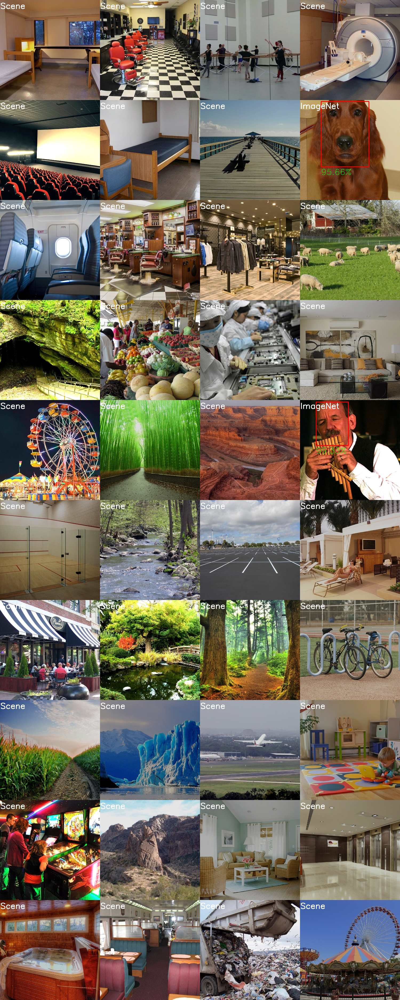

In [46]:
random_collage(test_df)

In [48]:
test_set[..., test_df.faces.notna()].shape

(72, 88, 67, 137)

In [49]:
# This test returns p-values that represent probabilities that the two
# time-series were not drawn from the same distribution. The lower the
# p-value, the more discriminative is the voxel in distinguishing the two
# conditions (faces and houses).
_, p_values = stats.ttest_ind(test_set[..., test_df.faces.notna()],
                              test_set[..., test_df.faces.isna()],
                              axis=-1)

In [62]:
# Use a log scale for p-values
log_p_values = -np.log10(p_values)
# NAN values to zero
log_p_values[np.isnan(log_p_values)] = 0.
log_p_values[log_p_values > 10.] = 10.

# Visualize statistical p-values using plotting function `plot_stat_map`
from nilearn.plotting import plot_stat_map

# Before visualizing, we transform the computed p-values to Nifti-like image
# using function `new_img_like` from nilearn.
from nilearn.image import new_img_like

# First argument being a reference image and second argument should be p-values
# data to convert to a new image as output. This new image will have same header
# information as reference image.
log_p_values_img = new_img_like(csi3_img, log_p_values)

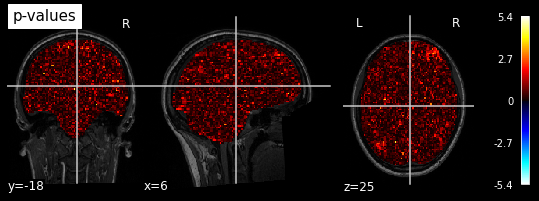

In [63]:
# Now, we visualize log p-values image on functional mean image as background
# with coordinates given manually and colorbar on the right side of plot (by
# default colorbar=True)
plot_stat_map(log_p_values_img, csi3_anat, symmetric_cbar=True, title="p-values")


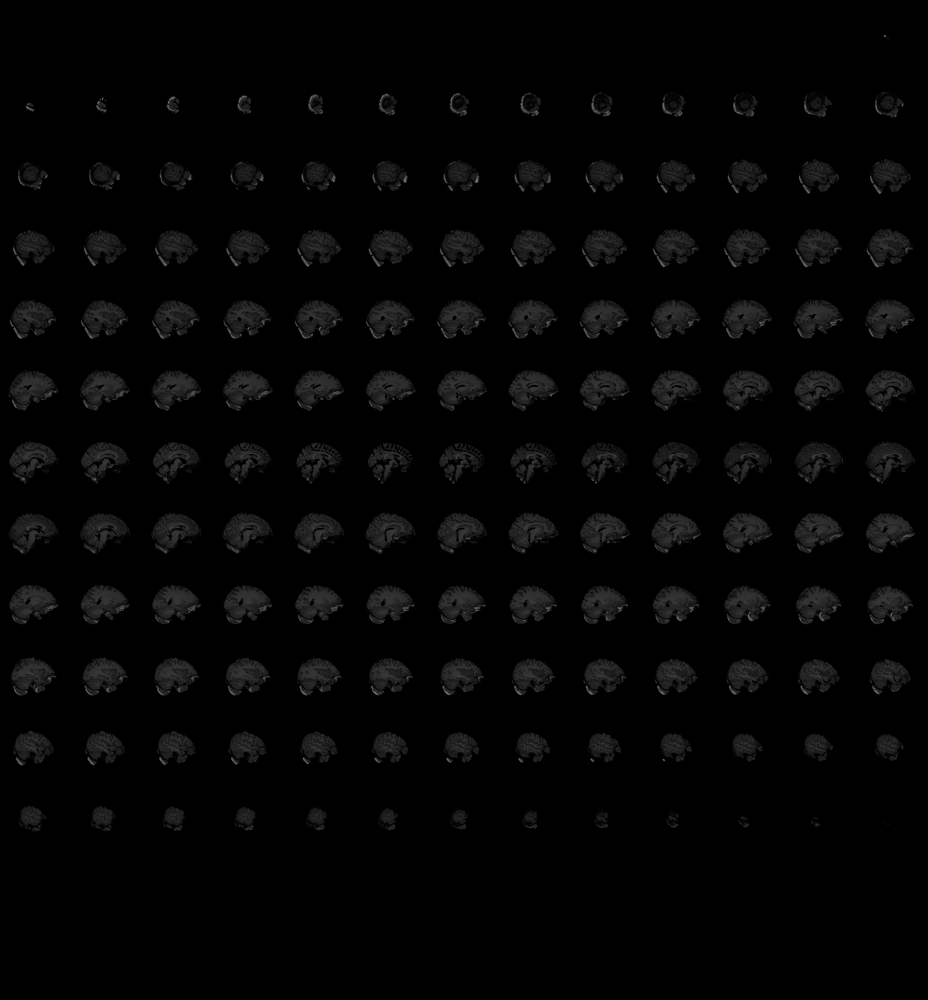
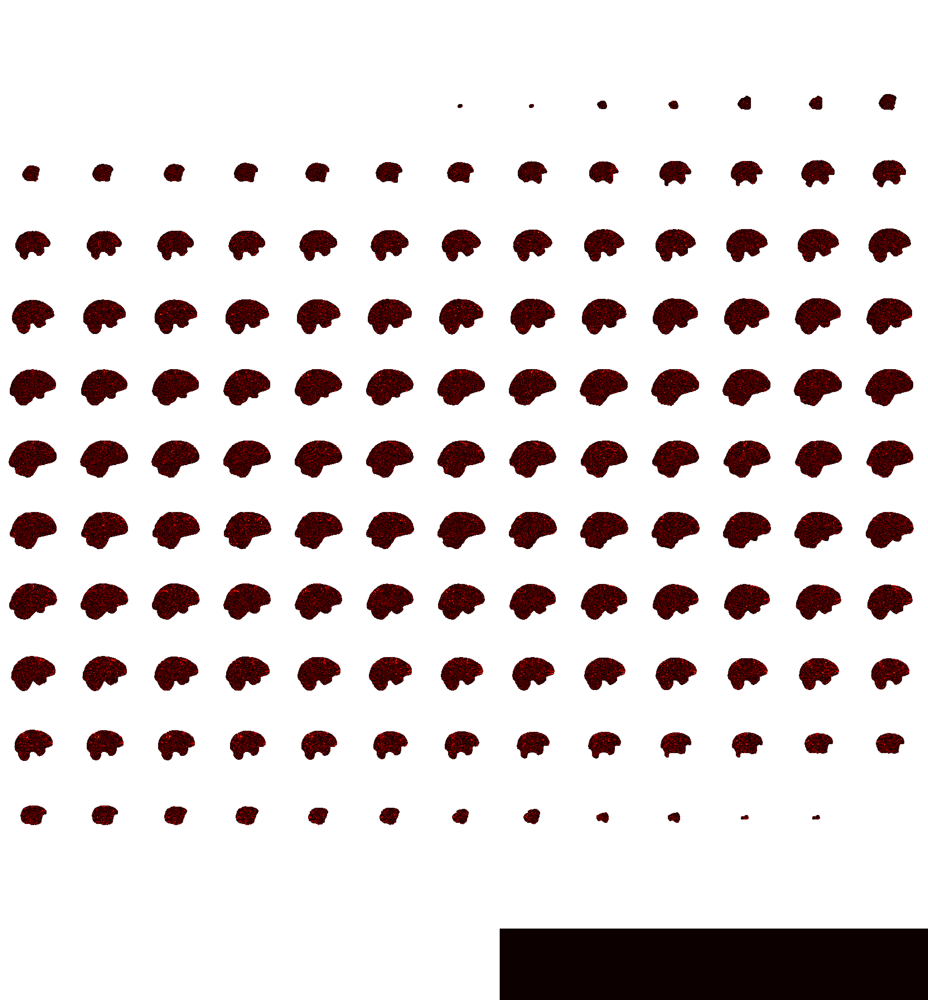

In [64]:
plotting.view_img(log_p_values_img, csi3_anat, title="p-values")

In [65]:
thresh_p_values = log_p_values.copy()
thresh_p_values[thresh_p_values < 2] = 0
thresh_img = new_img_like(csi3_img, thresh_p_values)


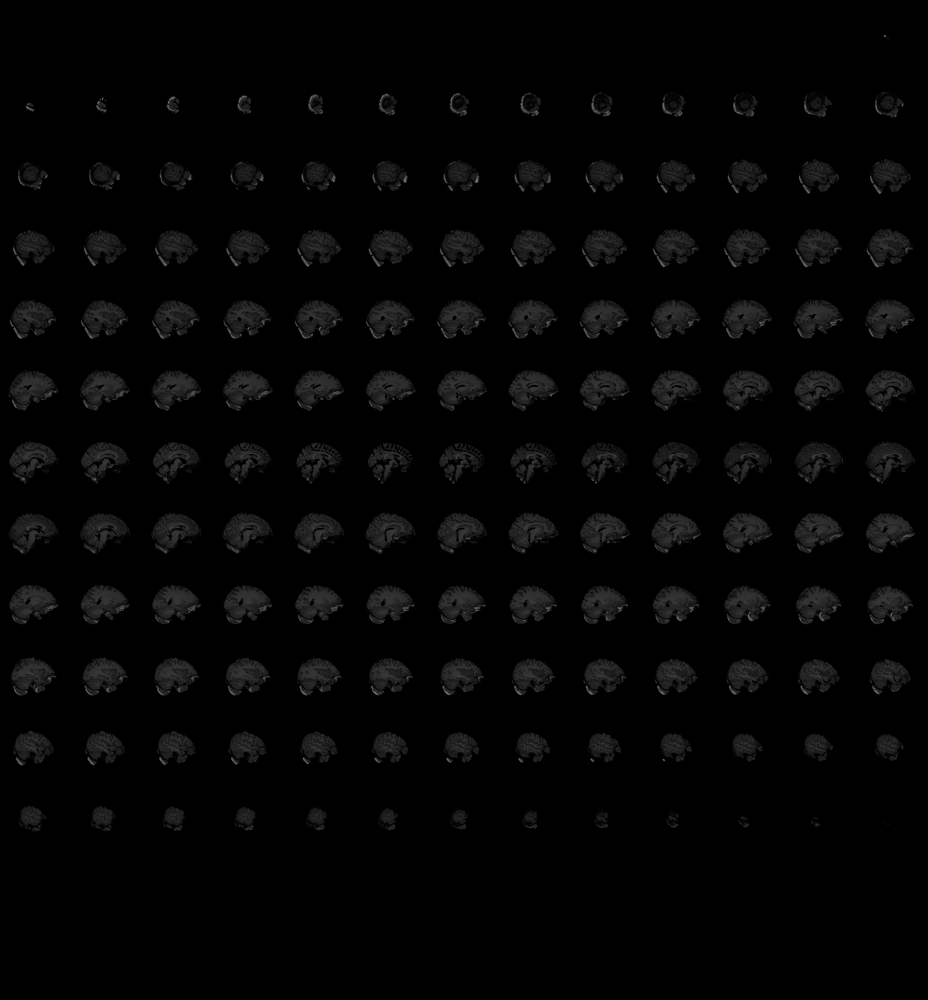
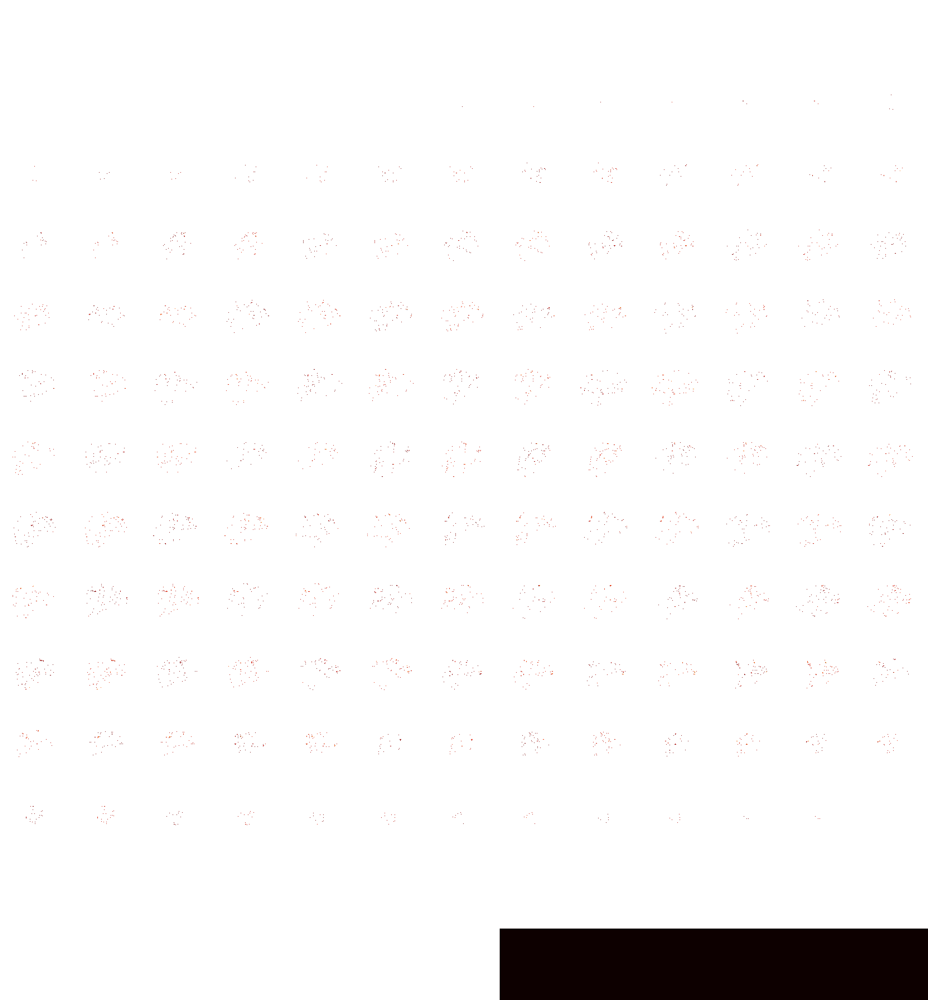

In [66]:
plotting.view_img(
    thresh_img,
    csi3_anat,
    colorbar=False
)

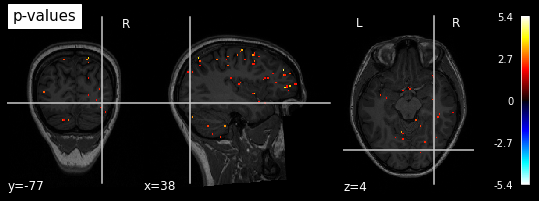

In [67]:
plot_stat_map(thresh_img, csi3_anat, cut_coords=(38,-77, 4), symmetric_cbar=True, title="p-values")

In [58]:
test_df = csi3_df[
    (csi3_df.dataset == "Scene") | (csi3_df.dataset == "ImageNet")
]

test_set = csi3_data[..., test_df.index]
test_set.shape

(72, 88, 67, 3121)

In [61]:
# This test returns p-values that represent probabilities that the two
# time-series were not drawn from the same distribution. The lower the
# p-value, the more discriminative is the voxel in distinguishing the two
# conditions (faces and houses).
_, p_values = stats.ttest_ind(test_set[..., (test_df.dataset == "Scene")],
                              test_set[..., (test_df.dataset == "ImageNet")],
                              axis=-1)

Index: 0 Name: Unknown
Index: 1 Name: mFus-faces
Index: 2 Name: pFus-faces
Index: 3 Name: IOG-faces
Index: 4 Name: OTS-bodies
Index: 5 Name: ITG-bodies
Index: 6 Name: MTG-bodies
Index: 7 Name: LOS-bodies
Index: 8 Name: CoS-places
Index: 9 Name: TOS-places
Index: 10 Name: hMT
Index: 11 Name: v1d
Index: 12 Name: v2d
Index: 13 Name: v3d
Index: 14 Name: v1v
Index: 15 Name: v2v
Index: 16 Name: v3v


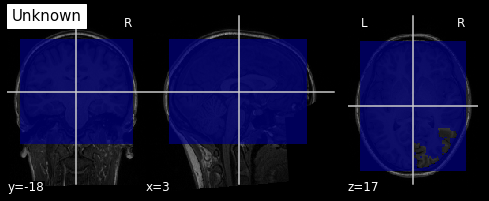

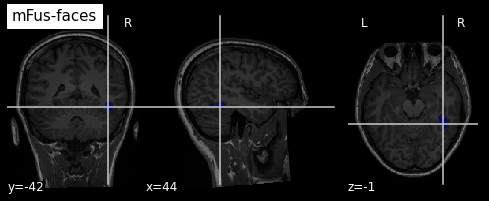

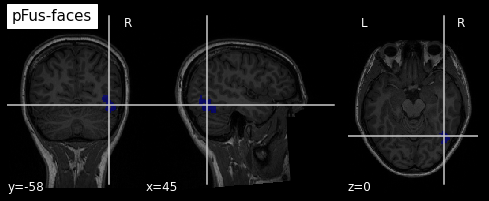

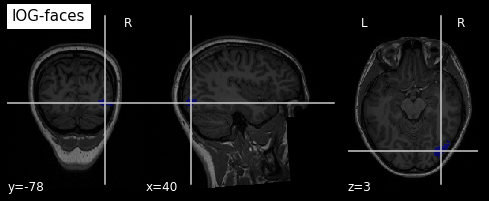

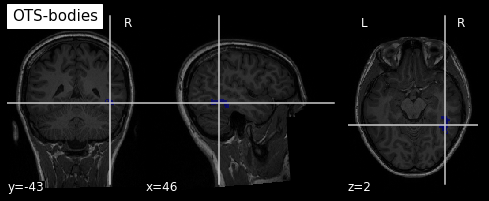

...

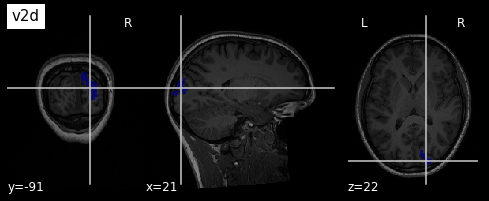

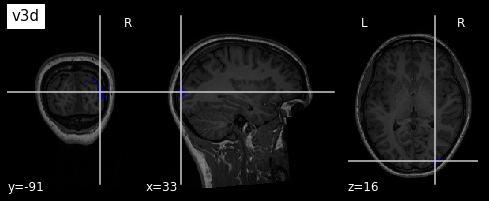

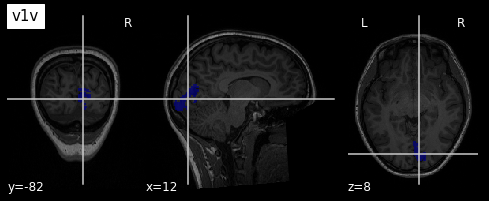

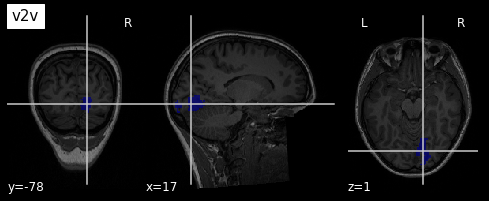

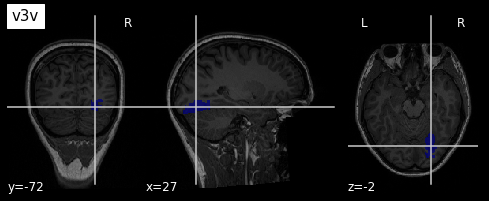

In [31]:
visfAtlas_lh_lut = pd.read_csv(Path('freesurfer') / 'lh.visfAtlasLUT.txt', sep='\t', index_col='#')
visfAtlas_rh_lut = pd.read_csv(Path('freesurfer') / 'rh.visfAtlasLUT.txt', sep='\t', index_col='#')
visfAtlas_img = nib.load('freesurfer/sub-CSI3/mri/rh.visfAtlas.nii.gz')
visfAtlas_data = visfAtlas_img.get_fdata()

for index, name in zip(visfAtlas_rh_lut.index, visfAtlas_rh_lut.Name):
    print(f'Index: {index} Name: {name}')
    mask = (visfAtlas_data == index).astype(int)
    plotting.plot_roi(nib.Nifti1Image(mask, visfAtlas_img.affine), csi3_anat, title=name)

In [83]:
np.max(thresh_p_values)

5.713884241509573

In [86]:
csi1_anat = nib.load(dataset_v1 / 'BOLD5000_Structural' / 'CSI1_Structural' / 'T1w_MPRAGE_CSI1.nii')
csi1_img = nib.load(dataset_v2 / f'CSI1_GLMbetas-TYPED-FITHRF-GLMDENOISE-RR-ZSCORE-ALL.nii.gz')
csi1_data = csi1_img.get_fdata()

In [87]:
csi1_df = sub_df = pd.read_pickle(dataset_v2 / 'CSI1_dataframe.pkl')
csi1_df = csi1_df.merge(face_df[['image', 'faces']], left_on='image', right_on='image')

In [17]:
def face_label(faces):
    if faces is None:
        return 'other'
    else:
        return 'face'

In [89]:
csi1_df.faces.map(face_label)

0       other
1       other
2       other
3       other
4       other
        ...  
5249    other
5250    other
5251    other
5252    other
5253     face
Name: faces, Length: 5254, dtype: object

In [93]:
Image(next(dataset_v2.glob(f'**/{csi1_df.iloc[5253].image}')))

TypeError: 'module' object is not callable

In [94]:
next(dataset_v2.glob(f'**/{csi1_df.iloc[5253].image}'))

PosixPath('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000r2/BOLD5000_Stimuli/Scene_Stimuli/Presented_Stimuli/COCO/COCO_train2014_000000292845.jpg')

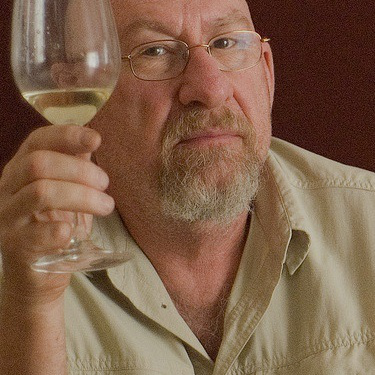

In [95]:
Image.open(next(dataset_v2.glob(f'**/{csi1_df.iloc[5253].image}')))

In [96]:
_, p_values = stats.ttest_ind(csi1_data[..., csi1_df.faces.notna()],
                              csi1_data[..., csi1_df.faces.isna()],
                              axis=-1)

In [99]:
# Use a log scale for p-values
log_p_values = -np.log10(p_values)
# NAN values to zero
log_p_values[np.isnan(log_p_values)] = 0.
log_p_values[log_p_values > 10.] = 10.
log_p_values_img = new_img_like(csi1_img, log_p_values)

/s/babbage/b/nobackup/nblancha/merry/conda/envs/fmri-gen/lib/python3.8/site-packages/nilearn/plotting/html_document.py:57: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than {} '



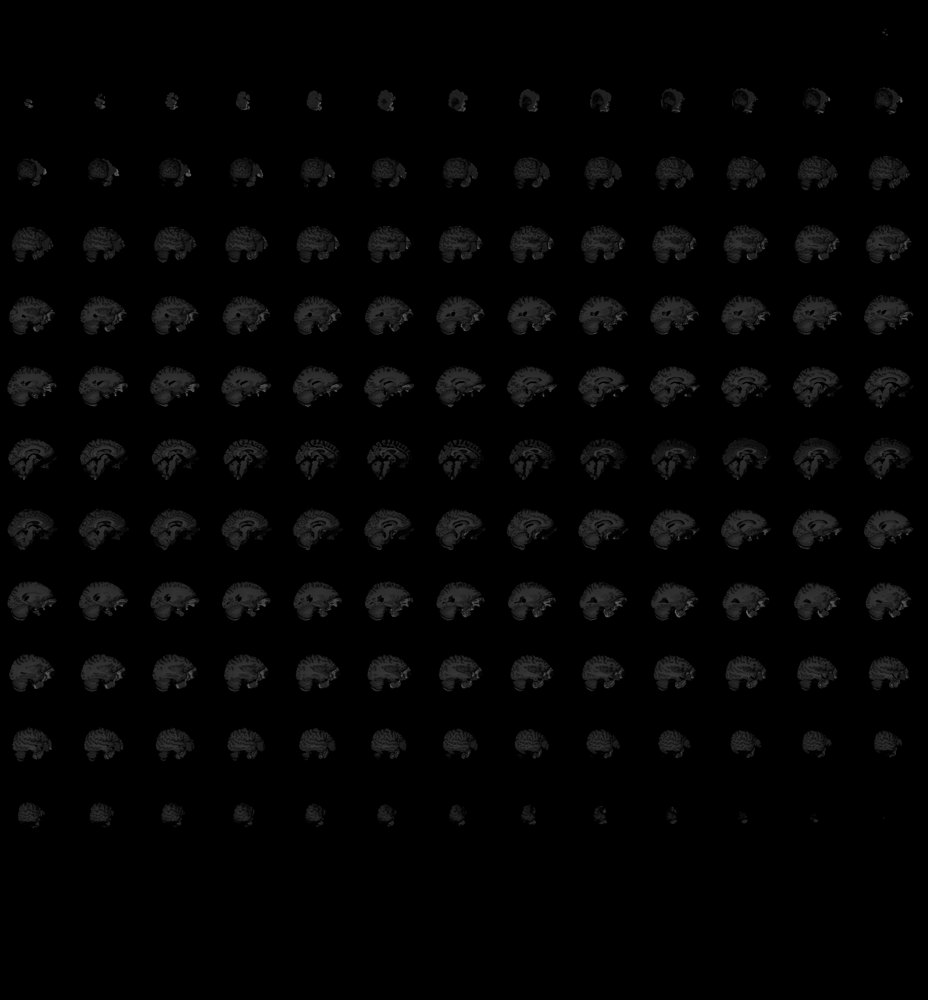
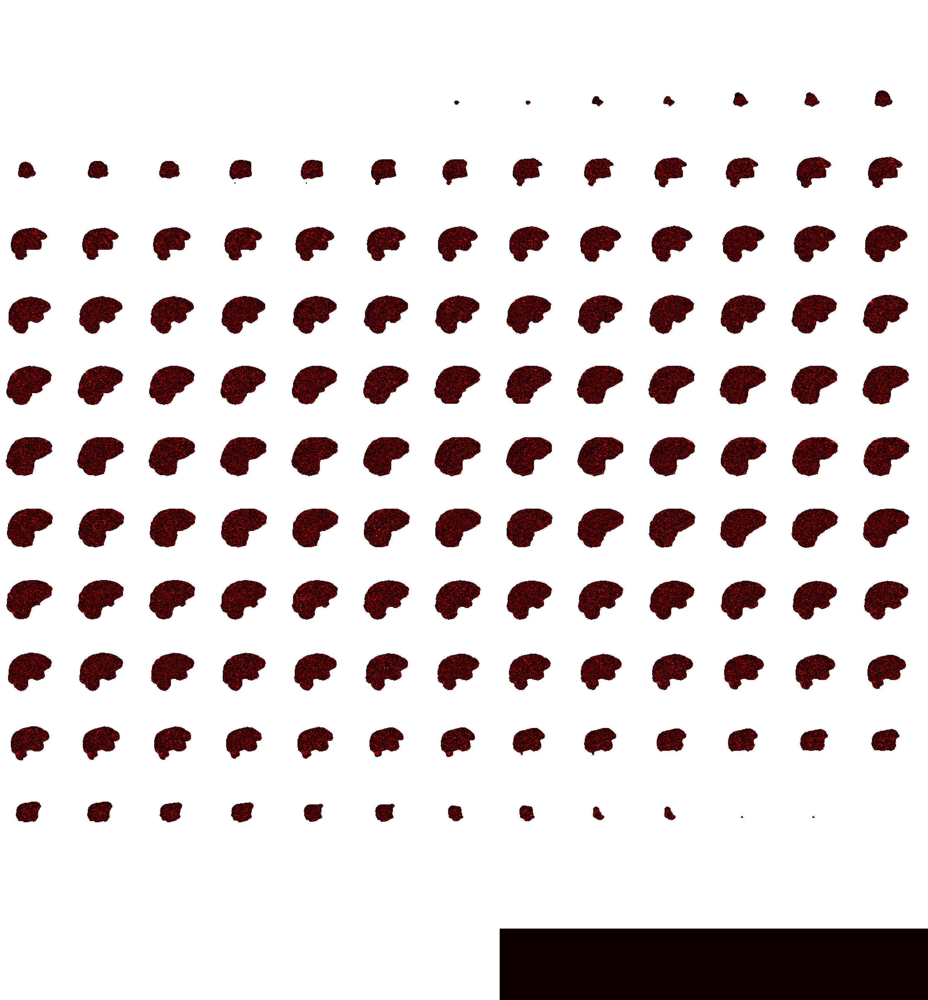

In [100]:
plotting.view_img(log_p_values_img, csi1_anat, title="p-values")

In [ ]:
from sklearn.feature_selection import f_classify

f_statistic, p_values = f_classify()

In [3]:
csi2_anat = nib.load(dataset_v1 / 'BOLD5000_Structural' / 'CSI2_Structural' / 'T1w_MPRAGE_CSI2.nii')
csi2_img = nib.load(dataset_v2 / f'CSI2_GLMbetas-TYPED-FITHRF-GLMDENOISE-RR-ZSCORE-ALL.nii.gz')
csi2_data = csi2_img.get_fdata()

In [6]:
csi2_df = sub_df = pd.read_pickle(dataset_v2 / 'CSI2_dataframe.pkl')
csi2_df = csi2_df.merge(face_df[['image', 'faces']], left_on='image', right_on='image')

In [7]:
csi2_df

,image,dataset,faces
0,n09468604_12427.JPEG,ImageNet,None
1,n01494475_3853.JPEG,ImageNet,None
2,COCO_train2014_000000312003.jpg,COCO,"[(0.89928627, 296, 1, 337, 87)]"
3,COCO_train2014_000000312003.jpg,COCO,"[(0.89928627, 296, 1, 337, 87)]"
4,COCO_train2014_000000312003.jpg,COCO,"[(0.89928627, 296, 1, 337, 87)]"
...,...,...,...
5249,waitingroom2.jpg,Scene,None
5250,COCO_train2014_000000224396.jpg,COCO,None
5251,COCO_train2014_000000539967.jpg,COCO,None
5252,n02085782_1848.JPEG,ImageNet,"[(0.97992545, 42, 20, 347, 334)]"


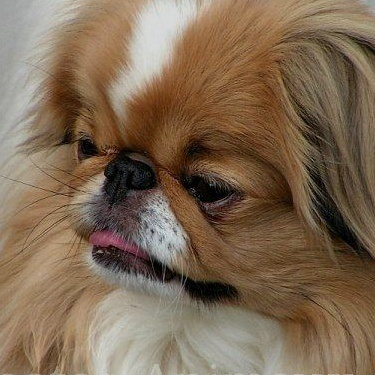

In [10]:
Image.open(next(dataset_v2.glob(f'**/{csi2_df.iloc[5252].image}')))

In [ ]:
_, p_values = stats.ttest_ind(csi2_data[..., csi2_df.faces.notna()],
                              csi2_data[..., csi2_df.faces.isna()],
                              axis=-1)

In [ ]:
# Use a log scale for p-values
log_p_values = -np.log10(p_values)
# NAN values to zero
log_p_values[np.isnan(log_p_values)] = 0.
log_p_values[log_p_values > 10.] = 10.
log_p_values_img = new_img_like(csi2_img, log_p_values)

In [ ]:
plotting.view_img(log_p_values_img, csi2_anat, title="p-values")

In [28]:
csi2_data.shape

(72, 92, 70, 5254)

In [31]:
csi2_mask_img = nib.load(dataset_v2 / f'CSI2_mask-BRAIN.nii.gz')
csi2_mask = csi2_mask_img.get_fdata()

In [32]:
csi2_mask.shape

(72, 92, 70)

In [33]:
csi2_mask

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [42]:
X = csi2_data

In [43]:
X.shape

(72, 92, 70, 5254)

In [44]:
X = X[csi2_mask != 0, :]

In [45]:
X.shape

(195156, 5254)

In [46]:
X = X.transpose()

In [47]:
X.shape

(5254, 195156)

In [48]:
y = csi2_df.faces.map(face_label).tolist()

In [49]:
len(y)

5254

In [50]:
np.count_nonzero(np.isnan(X))

0

In [51]:
from sklearn.feature_selection import SelectKBest, f_classif

f_statistic, p_values = f_classif(X, y)

In [52]:
np.max(p_values)

0.9999962941509581

In [ ]:
len(y)

In [53]:
log_p_values = -np.log10(p_values)

In [55]:
np.max(log_p_values)

5.317813468502577

In [56]:
log_p_values.shape

(195156,)